In [1]:
import os
import time
import librosa
import numpy as np
import pandas as pd
import librosa.display
import matplotlib.pyplot as plt

In [2]:
bc24_p_ta      = '/kaggle/input/birdclef-2024/train_audio/'
bc24_f_tmd     = '/kaggle/input/birdclef-2024/train_metadata.csv'
#--------------------------------------------------------------------
bc25_p_ta      = '/kaggle/input/birdclef-2025/train_audio/'
bc25_f_tmd     = '/kaggle/input/birdclef-2025/train.csv'

#### signal difference
- [BirdCLEF+ 2024 | signal difference](https://www.kaggle.com/code/vyacheslavbolotin/spectrogram-signal-difference)
- [BirdCLEF+ 2025 | signal difference](https://www.kaggle.com/code/vyacheslavbolotin/birdclef-2025-spectrogram-signal-difference/edit)

In [3]:
# mdf = pd.read_csv(bc24_f_tmd)
#--------------------------------------------------------------------
mdf = pd.read_csv(bc25_f_tmd)


# mdf['size'] = mdf['filename'].apply(lambda x: round(os.path.getsize(bc24_p_ta + x)/32_000, 1))
#--------------------------------------------------------------------
mdf['size'] = mdf['filename'].apply(lambda x: round(os.path.getsize(bc25_p_ta + x)/32_000, 1))


In [4]:
qbs,oggs,bird,ogga,oggas = 1,[],'bird_x',{},[]

for i, row in mdf.iterrows():
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    FiN = row['filename']
    if   len(FiN) == 18: FiN = FiN.replace('.ogg', '     .ogg')
    elif len(FiN) <= 19: FiN = FiN.replace('.ogg', '    .ogg')
    elif len(FiN) <= 20: FiN = FiN.replace('.ogg', '   .ogg')
    elif len(FiN) <= 21: FiN = FiN.replace('.ogg', '  .ogg')
    elif len(FiN) <= 22: FiN = FiN.replace('.ogg', ' .ogg')
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    sec = str(row['size'])
    if len(sec) == 3: sec = '  ' + sec
    elif len(sec) == 4: sec = ' ' + sec
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    BiN = FiN.split('/')[0]
    if bird == BiN:
        qbs += 1
    else:
        ogga['bird'] = bird
        ogga['qbs']  = qbs
        ogga['oggs'] = oggs
        oggas.append(ogga)
        qbs,oggs,bird,ogga = 1,[],'bird_x',{}
    # - - - - - - - - - - - - - - - "- - - - - - - - - - - - - -
    lrc = len(row['collection'])
    align = "" if lrc==4 else " " if lrc==3 else "  " 
    # - - - - - - - - - - - - - - - "- - - - - - - - - - - - - -
    oggs.append("{'file': '" + FiN + "',  'time':" + sec + ",  'collection':" + f"'{row['collection']}'" + align + ",   'type':" + row['type'] + '},\n')
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
    bird = BiN
    # - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

loggas = []
for oneDict in oggas:
    loggas.extend(['\n', oneDict['bird'] +'  '+ str(oneDict['qbs']), '\n\n'])
    loggas.extend(oneDict['oggs'])
    
with open('birdCLEF_2025_meta.txt', 'w') as f:
    f.writelines(loggas)

In [5]:
groggs = [
    [
{'file': 'norscr1/XC146508   .ogg',  'time': 35.0,  'collection':'XC'  ,   'type':['call']},
{'file': 'norscr1/XC148047   .ogg',  'time': 34.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'norscr1/XC178590   .ogg',  'time': 23.7,  'collection':'XC'  ,   'type':['song']},
{'file': 'norscr1/XC178594   .ogg',  'time': 26.9,  'collection':'XC'  ,   'type':['song']},
{'file': 'norscr1/XC178596   .ogg',  'time': 12.7,  'collection':'XC'  ,   'type':['song']},
# {'file': 'norscr1/XC178597   .ogg',  'time': 18.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'norscr1/XC574244   .ogg',  'time':  1.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'norscr1/XC6866     .ogg',  'time':  7.4,  'collection':'XC'  ,   'type':['call']},
# {'file': 'norscr1/XC774954   .ogg',  'time':  2.5,  'collection':'XC'  ,   'type':['song']},
# {'file': 'norscr1/XC793433   .ogg',  'time':  4.4,  'collection':'XC'  ,   'type':['']},
# {'file': 'norscr1/XC793440   .ogg',  'time':  9.6,  'collection':'XC'  ,   'type':['']},
# {'file': 'norscr1/XC820356   .ogg',  'time':  3.3,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'norscr1/iNat31894  .ogg',  'time':  4.5,  'collection':'iNat',   'type':['']},
# {'file': 'norscr1/iNat744289 .ogg',  'time':  2.5,  'collection':'iNat',   'type':['']},
    ],
    [
{'file': 'olipic1/XC114212   .ogg',  'time':  9.1,  'collection':'XC'  ,   'type':['call']},
{'file': 'olipic1/XC149121   .ogg',  'time':  4.4,  'collection':'XC'  ,   'type':['call']},
{'file': 'olipic1/XC172177   .ogg',  'time':  5.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'olipic1/XC178646   .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['song']},
{'file': 'olipic1/XC194578   .ogg',  'time':  6.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC217686   .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC235013   .ogg',  'time':  8.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC245139   .ogg',  'time':  7.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC261872   .ogg',  'time':  7.2,  'collection':'XC'  ,   'type':['call', 'song', 'calls']},
# {'file': 'olipic1/XC275313   .ogg',  'time':  6.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC275314   .ogg',  'time':  2.5,  'collection':'XC'  ,   'type':['song']},
# {'file': 'olipic1/XC282536   .ogg',  'time':  6.0,  'collection':'XC'  ,   'type':['song']},
    ],
    [
{'file': 'orcpar/XC125595    .ogg',  'time':  5.7,  'collection':'XC'  ,   'type':['call', 'flight call']},
{'file': 'orcpar/XC137805    .ogg',  'time': 21.8,  'collection':'XC'  ,   'type':['call']},
{'file': 'orcpar/XC149084    .ogg',  'time':  3.4,  'collection':'XC'  ,   'type':['song']},
{'file': 'orcpar/XC149086    .ogg',  'time':  3.5,  'collection':'XC'  ,   'type':['song']},
{'file': 'orcpar/XC151974    .ogg',  'time':  8.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC151977    .ogg',  'time':  6.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC162236    .ogg',  'time':  7.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC169912    .ogg',  'time': 20.6,  'collection':'XC'  ,   'type':['sonido grupal']},
# {'file': 'orcpar/XC178611    .ogg',  'time': 22.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC178612    .ogg',  'time': 11.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC189097    .ogg',  'time':  4.0,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC189439    .ogg',  'time':  7.0,  'collection':'XC'  ,   'type':['call']},
# {'file': 'orcpar/XC196773    .ogg',  'time':  3.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'orcpar/XC233527    .ogg',  'time':  1.9,  'collection':'XC'  ,   'type':['call']},
    ],
    [
{'file': 'piwtyr1/XC279505   .ogg',  'time':  9.6,  'collection':'XC'  ,   'type':['song']},
{'file': 'piwtyr1/XC318586   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['call']},
{'file': 'piwtyr1/XC354869   .ogg',  'time':  6.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'piwtyr1/XC412796   .ogg',  'time':  8.1,  'collection':'XC'  ,   'type':['call']},
{'file': 'piwtyr1/XC479102   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'piwtyr1/XC56959    .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['rattle']},
# {'file': 'piwtyr1/XC56987    .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'piwtyr1/XC56988    .ogg',  'time':  0.7,  'collection':'XC'  ,   'type':['song']},
# {'file': 'piwtyr1/XC56989    .ogg',  'time':  0.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'piwtyr1/XC66003    .ogg',  'time':  4.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'piwtyr1/XC66048    .ogg',  'time':  3.6,  'collection':'XC'  ,   'type':['song']},
# {'file': 'piwtyr1/XC6886     .ogg',  'time':  3.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'piwtyr1/XC820366   .ogg',  'time': 27.1,  'collection':'XC'  ,   'type':['call', 'song']},
    ],
    [
{'file': 'plbwoo1/XC235227   .ogg',  'time':  7.5,  'collection':'XC'  ,   'type':['song']},
{'file': 'plbwoo1/XC235233   .ogg',  'time': 14.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'plbwoo1/XC235670   .ogg',  'time':  2.7,  'collection':'XC'  ,   'type':['song']},
{'file': 'plbwoo1/XC235671   .ogg',  'time':  2.5,  'collection':'XC'  ,   'type':['song']},
{'file': 'plbwoo1/XC235672   .ogg',  'time': 14.0,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plbwoo1/XC235675   .ogg',  'time': 13.1,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plbwoo1/XC235676   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'plbwoo1/XC244812   .ogg',  'time':  2.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plbwoo1/XC245205   .ogg',  'time': 38.4,  'collection':'XC'  ,   'type':['dawn song']},
    ],
    [
{'file': 'plctan1/XC253746   .ogg',  'time':  6.4,  'collection':'XC'  ,   'type':['call']},
{'file': 'plctan1/XC364102   .ogg',  'time': 17.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'plctan1/XC454085   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['call', 'flight call']},
{'file': 'plctan1/XC454405   .ogg',  'time':  3.4,  'collection':'XC'  ,   'type':['call']},
{'file': 'plctan1/XC455604   .ogg',  'time':  3.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'plctan1/XC639642   .ogg',  'time': 13.9,  'collection':'XC'  ,   'type':['call']},
    ],
    [
{'file': 'plukit1/XC113752   .ogg',  'time':  3.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'plukit1/XC119424   .ogg',  'time':  4.3,  'collection':'XC'  ,   'type':['song']},
{'file': 'plukit1/XC152825   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['call']},
{'file': 'plukit1/XC154392   .ogg',  'time': 13.2,  'collection':'XC'  ,   'type':['flight call']},
{'file': 'plukit1/XC174065   .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plukit1/XC174454   .ogg',  'time':  7.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plukit1/XC203895   .ogg',  'time': 11.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'plukit1/XC216119   .ogg',  'time':  1.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'plukit1/XC260333   .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'plukit1/XC295750   .ogg',  'time':  0.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'plukit1/XC421627   .ogg',  'time':  4.1,  'collection':'XC'  ,   'type':['flight call', 'song']},
# {'file': 'plukit1/XC447885   .ogg',  'time':  1.2,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'plukit1/XC448485   .ogg',  'time':  3.6,  'collection':'XC'  ,   'type':['song']},
# {'file': 'plukit1/XC452487   .ogg',  'time':  7.2,  'collection':'XC'  ,   'type':['call']},
    ],
    [
{'file': 'purgal2/XC109039   .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['call']},
{'file': 'purgal2/XC113925   .ogg',  'time':  9.3,  'collection':'XC'  ,   'type':['call']},
{'file': 'purgal2/XC113926   .ogg',  'time': 16.2,  'collection':'XC'  ,   'type':['begging call']},
{'file': 'purgal2/XC123921   .ogg',  'time':  4.0,  'collection':'XC'  ,   'type':['call', 'song']},
{'file': 'purgal2/XC130986   .ogg',  'time':  4.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC131141   .ogg',  'time': 13.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC131146   .ogg',  'time':  2.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC131340   .ogg',  'time':  1.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC143689   .ogg',  'time': 19.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC143690   .ogg',  'time': 12.9,  'collection':'XC'  ,   'type':['call', 'flight call']},
# {'file': 'purgal2/XC143691   .ogg',  'time': 13.9,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC143693   .ogg',  'time':  6.0,  'collection':'XC'  ,   'type':['call']},
# {'file': 'purgal2/XC145702   .ogg',  'time':  2.9,  'collection':'XC'  ,   'type':['flight call']},
    ],
    [
{'file': 'rebbla1/XC213693   .ogg',  'time': 17.0,  'collection':'XC'  ,   'type':['call']},
{'file': 'rebbla1/XC213694   .ogg',  'time':  5.6,  'collection':'XC'  ,   'type':['call']},
{'file': 'rebbla1/XC221570   .ogg',  'time':  3.7,  'collection':'XC'  ,   'type':['call']},
{'file': 'rebbla1/XC251575   .ogg',  'time': 34.7,  'collection':'XC'  ,   'type':['song']},
{'file': 'rebbla1/XC257157   .ogg',  'time':  6.8,  'collection':'XC'  ,   'type':['flight song', 'song']},
# {'file': 'rebbla1/XC257158   .ogg',  'time':  4.9,  'collection':'XC'  ,   'type':['flight call', 'flight song', 'flight calls']},
# {'file': 'rebbla1/XC257159   .ogg',  'time':  3.2,  'collection':'XC'  ,   'type':['call', 'calls']},
# {'file': 'rebbla1/XC340165   .ogg',  'time':  4.1,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC346174   .ogg',  'time':  7.6,  'collection':'XC'  ,   'type':['call', 'song']},
# {'file': 'rebbla1/XC355150   .ogg',  'time': 18.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC355151   .ogg',  'time':  5.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC356782   .ogg',  'time': 46.1,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC389860   .ogg',  'time': 26.4,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC395375   .ogg',  'time':  5.1,  'collection':'XC'  ,   'type':['call', 'song']},
# {'file': 'rebbla1/XC399483   .ogg',  'time': 21.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC401166   .ogg',  'time': 26.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rebbla1/XC407353   .ogg',  'time': 12.4,  'collection':'XC'  ,   'type':['song']},
    ],
    [
{'file': 'rosspo1/XC418905   .ogg',  'time':  3.9,  'collection':'XC'  ,   'type':['call']},
{'file': 'rosspo1/XC444930   .ogg',  'time':  1.7,  'collection':'XC'  ,   'type':['song']},
{'file': 'rosspo1/XC444931   .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['song']},
{'file': 'rosspo1/XC451675   .ogg',  'time':  3.1,  'collection':'XC'  ,   'type':['call']},
{'file': 'rosspo1/XC451725   .ogg',  'time':  1.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rosspo1/XC47067    .ogg',  'time': 15.8,  'collection':'XC'  ,   'type':['call', 'call on ground']},
# {'file': 'rosspo1/XC572432   .ogg',  'time': 10.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rosspo1/XC572475   .ogg',  'time': 16.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rosspo1/XC623963   .ogg',  'time': 56.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rosspo1/XC657822   .ogg',  'time': 21.4,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rosspo1/XC657826   .ogg',  'time': 11.9,  'collection':'XC'  ,   'type':['call', 'wing sound']},
# {'file': 'rosspo1/XC70541    .ogg',  'time':  3.2,  'collection':'XC'  ,   'type':['alarm call']},
# {'file': 'rosspo1/XC70542    .ogg',  'time':  4.7,  'collection':'XC'  ,   'type':['alarm call']},
    ],
    [
{'file': 'rtlhum/XC115487    .ogg',  'time':  4.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'rtlhum/XC122521    .ogg',  'time':  6.2,  'collection':'XC'  ,   'type':['call']},
{'file': 'rtlhum/XC128384    .ogg',  'time':  4.1,  'collection':'XC'  ,   'type':['song']},
{'file': 'rtlhum/XC129709    .ogg',  'time':  4.7,  'collection':'XC'  ,   'type':['flight call']},
{'file': 'rtlhum/XC135249    .ogg',  'time':  9.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rtlhum/XC137684    .ogg',  'time':  1.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rtlhum/XC137685    .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rtlhum/XC154041    .ogg',  'time':125.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rtlhum/XC156383    .ogg',  'time':  1.6,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rtlhum/XC163521    .ogg',  'time':  1.1,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'rtlhum/XC163522    .ogg',  'time':  2.1,  'collection':'XC'  ,   'type':['call', 'flight call']},
    ],
    [
{'file': 'rubsee1/XC317602   .ogg',  'time': 14.3,  'collection':'XC'  ,   'type':['song']},
{'file': 'rubsee1/XC317603   .ogg',  'time': 20.3,  'collection':'XC'  ,   'type':['song']},
{'file': 'rubsee1/XC327349   .ogg',  'time':  6.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'rubsee1/XC354892   .ogg',  'time': 14.1,  'collection':'XC'  ,   'type':['call']},
{'file': 'rubsee1/XC376169   .ogg',  'time': 39.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rubsee1/XC384213   .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rubsee1/XC384657   .ogg',  'time': 50.0,  'collection':'XC'  ,   'type':['call', 'song']},
# {'file': 'rubsee1/XC384679   .ogg',  'time':  3.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rubsee1/XC384719   .ogg',  'time':  2.6,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rubsee1/XC385747   .ogg',  'time': 16.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rubsee1/XC385750   .ogg',  'time': 29.7,  'collection':'XC'  ,   'type':['song']},
    ],
    [
{'file': 'rugdov/iNat398240  .ogg',  'time':  3.4,  'collection':'iNat',   'type':['']},
{'file': 'rugdov/iNat418112  .ogg',  'time':  2.4,  'collection':'iNat',   'type':['']},
{'file': 'rugdov/iNat448578  .ogg',  'time':  2.6,  'collection':'iNat',   'type':['']},
{'file': 'rugdov/iNat458955  .ogg',  'time':  6.9,  'collection':'iNat',   'type':['']},
{'file': 'rugdov/iNat545238  .ogg',  'time':  1.2,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat577883  .ogg',  'time':  2.0,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat587681  .ogg',  'time':  5.0,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat656090  .ogg',  'time':  3.0,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat681496  .ogg',  'time':  3.1,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat754491  .ogg',  'time': 14.1,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat889406  .ogg',  'time':  1.5,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat895266  .ogg',  'time':  5.4,  'collection':'iNat',   'type':['']},
# {'file': 'rugdov/iNat955037  .ogg',  'time':  3.3,  'collection':'iNat',   'type':['']},
    ],
    [
{'file': 'rutpuf1/XC162900   .ogg',  'time':  2.8,  'collection':'XC'  ,   'type':['song']},
{'file': 'rutpuf1/XC178652   .ogg',  'time': 17.1,  'collection':'XC'  ,   'type':['song']},
{'file': 'rutpuf1/XC178653   .ogg',  'time': 17.6,  'collection':'XC'  ,   'type':['song']},
{'file': 'rutpuf1/XC204478   .ogg',  'time': 14.4,  'collection':'XC'  ,   'type':['duet', 'song']},
{'file': 'rutpuf1/XC204479   .ogg',  'time':  3.1,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rutpuf1/XC204480   .ogg',  'time': 10.0,  'collection':'XC'  ,   'type':['duet', 'song']},
# {'file': 'rutpuf1/XC234314   .ogg',  'time':  3.9,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rutpuf1/XC312363   .ogg',  'time':  5.5,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rutpuf1/XC317697   .ogg',  'time':  3.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rutpuf1/XC318491   .ogg',  'time':  4.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rutpuf1/XC361202   .ogg',  'time':  3.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'rutpuf1/XC389158   .ogg',  'time':  4.4,  'collection':'XC'  ,   'type':['flight call', 'song']},
# {'file': 'rutpuf1/XC389159   .ogg',  'time':  2.7,  'collection':'XC'  ,   'type':['flight call', 'song']},
# {'file': 'rutpuf1/XC397479   .ogg',  'time':  8.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'rutpuf1/XC525046   .ogg',  'time': 21.0,  'collection':'XC'  ,   'type':['']},
# {'file': 'rutpuf1/XC661041   .ogg',  'time':  4.1,  'collection':'XC'  ,   'type':['aberrant', 'song']},
# {'file': 'rutpuf1/iNat508144 .ogg',  'time':  1.3,  'collection':'iNat',   'type':['']},
    ],
    [
{'file': 'saffin/iNat848856  .ogg',  'time':  3.5,  'collection':'iNat',   'type':['']},
{'file': 'saffin/iNat850181  .ogg',  'time':  2.6,  'collection':'iNat',   'type':['']},
{'file': 'saffin/iNat850823  .ogg',  'time':  2.1,  'collection':'iNat',   'type':['']},
{'file': 'saffin/iNat852145  .ogg',  'time':  1.6,  'collection':'iNat',   'type':['']},
{'file': 'saffin/iNat852517  .ogg',  'time':  3.1,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat852558  .ogg',  'time':  5.0,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat852559  .ogg',  'time':  2.8,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat852717  .ogg',  'time':  3.0,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat855306  .ogg',  'time':  9.6,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat858660  .ogg',  'time':  3.4,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat863424  .ogg',  'time':  1.4,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat864030  .ogg',  'time':  2.6,  'collection':'iNat',   'type':['']},
# {'file': 'saffin/iNat869981  .ogg',  'time':  2.8,  'collection':'iNat',   'type':['']},
    ],
    [
{'file': 'sahpar1/XC116987   .ogg',  'time':  4.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'sahpar1/XC149742   .ogg',  'time':  6.6,  'collection':'XC'  ,   'type':['call', 'song']},
{'file': 'sahpar1/XC15209    .ogg',  'time':  1.9,  'collection':'XC'  ,   'type':['flight call']},
{'file': 'sahpar1/XC178654   .ogg',  'time':  5.9,  'collection':'XC'  ,   'type':['song']},
{'file': 'sahpar1/XC24333    .ogg',  'time':  2.8,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'sahpar1/XC254102   .ogg',  'time':  1.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'sahpar1/XC26915    .ogg',  'time': 13.1,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'sahpar1/XC26916    .ogg',  'time':  0.7,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'sahpar1/XC26917    .ogg',  'time':  5.4,  'collection':'XC'  ,   'type':['flight call']},
# {'file': 'sahpar1/XC354130   .ogg',  'time':  2.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'sahpar1/XC354131   .ogg',  'time':  9.5,  'collection':'XC'  ,   'type':['call']},
# {'file': 'sahpar1/XC402590   .ogg',  'time':  8.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'sahpar1/XC414460   .ogg',  'time':  7.4,  'collection':'XC'  ,   'type':['call']},
# {'file': 'sahpar1/iNat51287  .ogg',  'time':  5.2,  'collection':'iNat',   'type':['']},
    ],
    [
{'file': 'smbani/XC461360    .ogg',  'time':  0.8,  'collection':'XC'  ,   'type':['call']},
{'file': 'smbani/XC470820    .ogg',  'time':  8.8,  'collection':'XC'  ,   'type':['call']},
{'file': 'smbani/XC48719     .ogg',  'time':  3.1,  'collection':'XC'  ,   'type':['call']},
{'file': 'smbani/XC48720     .ogg',  'time':  2.8,  'collection':'XC'  ,   'type':['call']},
{'file': 'smbani/XC493250    .ogg',  'time':  5.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'smbani/XC498195    .ogg',  'time': 18.4,  'collection':'XC'  ,   'type':['song']},
# {'file': 'smbani/XC50491     .ogg',  'time':  2.6,  'collection':'XC'  ,   'type':['song']},
# {'file': 'smbani/XC50492     .ogg',  'time':  0.9,  'collection':'XC'  ,   'type':['song']},
    ],
    [
{'file': 'socfly1/XC57751    .ogg',  'time':  1.8,  'collection':'XC'  ,   'type':['song']},
{'file': 'socfly1/XC57752    .ogg',  'time':  2.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'socfly1/XC57753    .ogg',  'time':  2.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'socfly1/XC57754    .ogg',  'time':  1.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'socfly1/XC57755    .ogg',  'time':  1.1,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC57756    .ogg',  'time':  1.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC57757    .ogg',  'time':  3.0,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC57758    .ogg',  'time':  2.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC57759    .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC57760    .ogg',  'time':  1.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC58272    .ogg',  'time':  2.6,  'collection':'XC'  ,   'type':['call']},
# {'file': 'socfly1/XC58273    .ogg',  'time':  2.3,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC58274    .ogg',  'time':  1.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'socfly1/XC584783   .ogg',  'time': 10.3,  'collection':'XC'  ,   'type':['call']},
    ],
    [
{'file': 'spbwoo1/XC113960   .ogg',  'time':  3.3,  'collection':'XC'  ,   'type':['song']},
{'file': 'spbwoo1/XC141609   .ogg',  'time':  4.2,  'collection':'XC'  ,   'type':['song']},
{'file': 'spbwoo1/XC146536   .ogg',  'time':  2.0,  'collection':'XC'  ,   'type':['song']},
{'file': 'spbwoo1/XC147267   .ogg',  'time':  6.3,  'collection':'XC'  ,   'type':['drumming', 'song']},
{'file': 'spbwoo1/XC156309   .ogg',  'time':  9.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spbwoo1/XC179535   .ogg',  'time':  3.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spbwoo1/XC180694   .ogg',  'time':  4.2,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spbwoo1/XC188184   .ogg',  'time':  2.4,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spbwoo1/XC196412   .ogg',  'time':  2.6,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spbwoo1/XC254141   .ogg',  'time':  1.6,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spbwoo1/XC258033   .ogg',  'time':  4.4,  'collection':'XC'  ,   'type':['call']},
    ],
    [
{'file': 'spepar1/XC245448   .ogg',  'time':  3.3,  'collection':'XC'  ,   'type':['song']},
{'file': 'spepar1/XC305336   .ogg',  'time':  4.3,  'collection':'XC'  ,   'type':['call']},
{'file': 'spepar1/XC315206   .ogg',  'time': 14.7,  'collection':'XC'  ,   'type':['song']},
{'file': 'spepar1/XC317792   .ogg',  'time':  2.7,  'collection':'XC'  ,   'type':['flight call']},
{'file': 'spepar1/XC319634   .ogg',  'time': 15.2,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spepar1/XC320345   .ogg',  'time':  1.4,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spepar1/XC320353   .ogg',  'time': 21.1,  'collection':'XC'  ,   'type':['flight call', 'song']},
# {'file': 'spepar1/XC354206   .ogg',  'time':  1.8,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spepar1/XC379420   .ogg',  'time': 12.9,  'collection':'XC'  ,   'type':['song']},
# {'file': 'spepar1/XC386426   .ogg',  'time': 28.7,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spepar1/XC428296   .ogg',  'time':  7.3,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spepar1/XC428297   .ogg',  'time': 10.1,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spepar1/XC428673   .ogg',  'time': 26.1,  'collection':'XC'  ,   'type':['call']},
# {'file': 'spepar1/XC432957   .ogg',  'time':  9.8,  'collection':'XC'  ,   'type':['call']},
    ]
]


 44.0


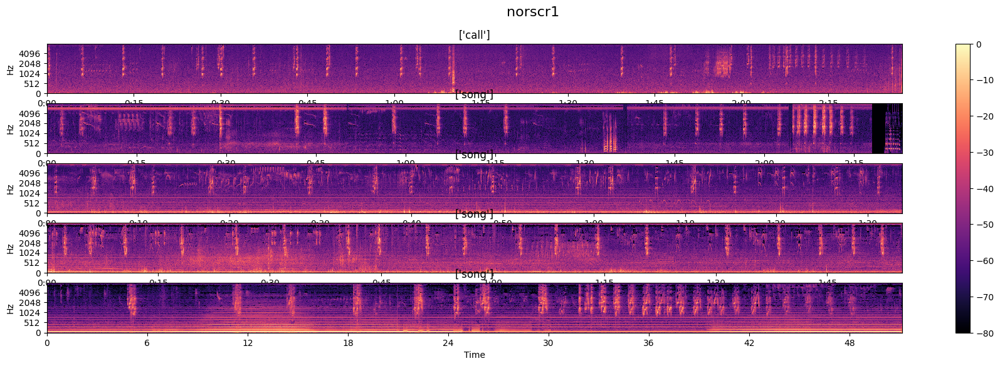

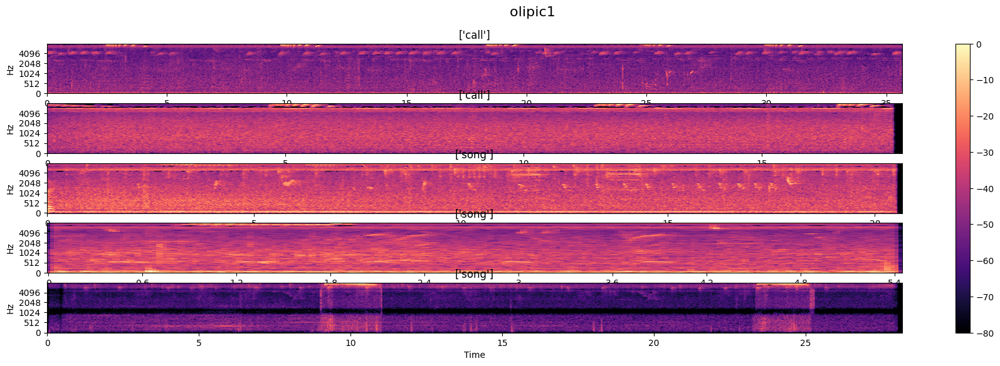

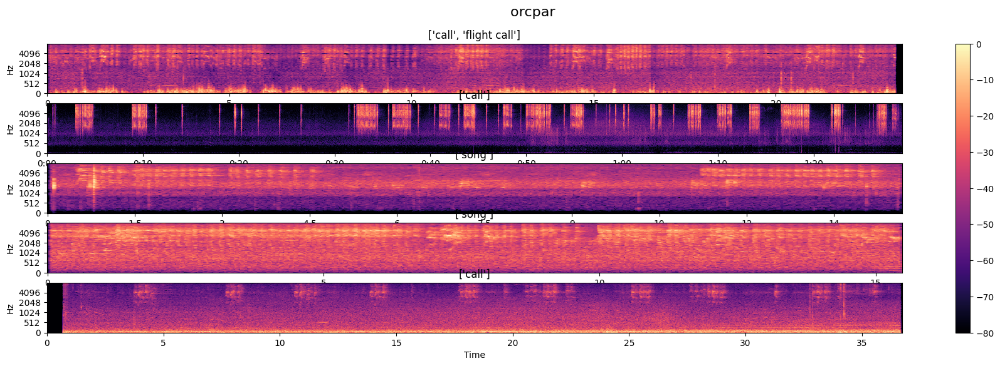

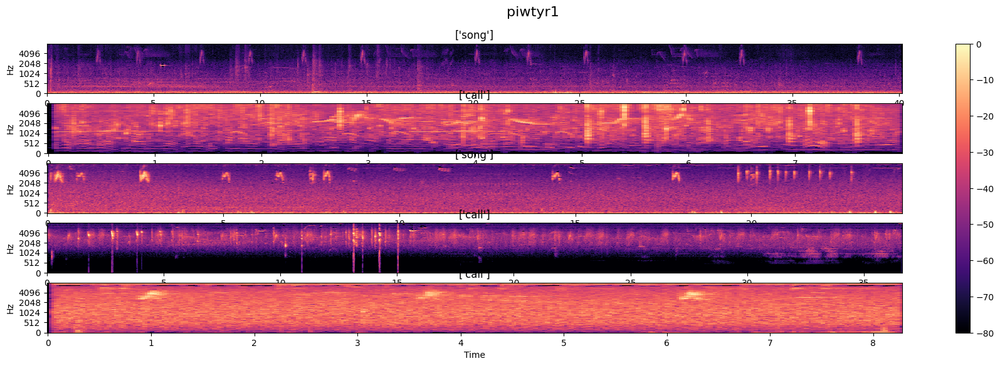

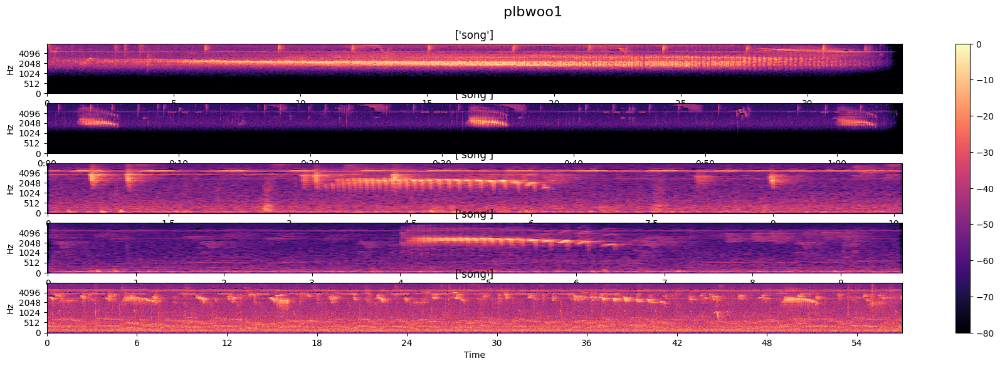

...

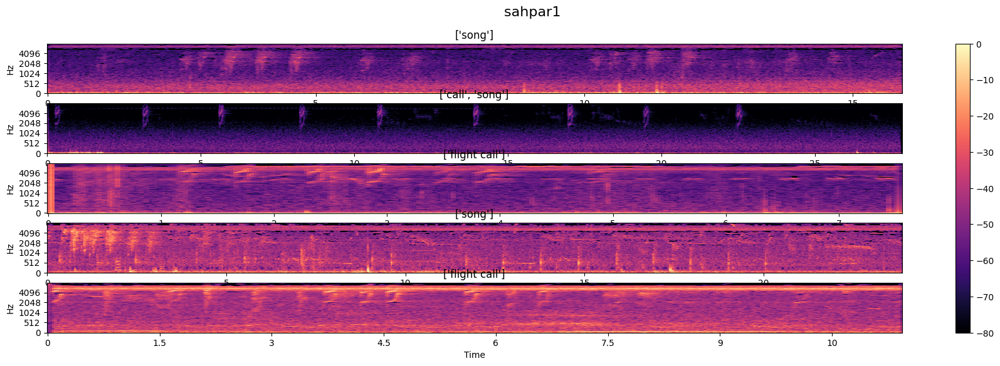

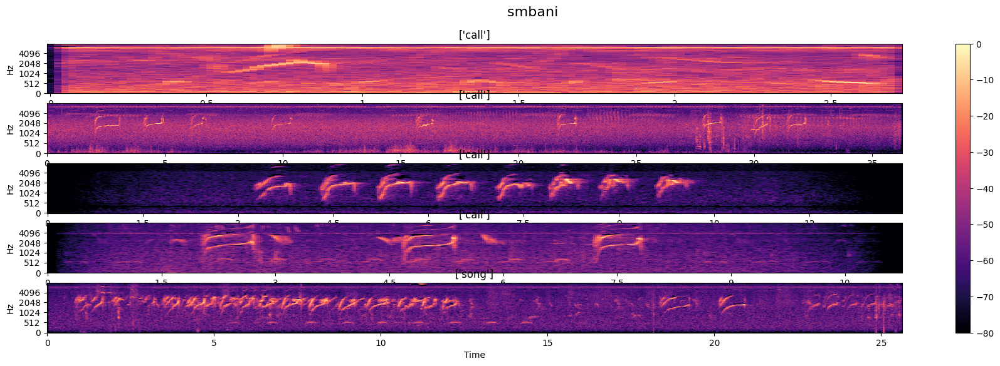

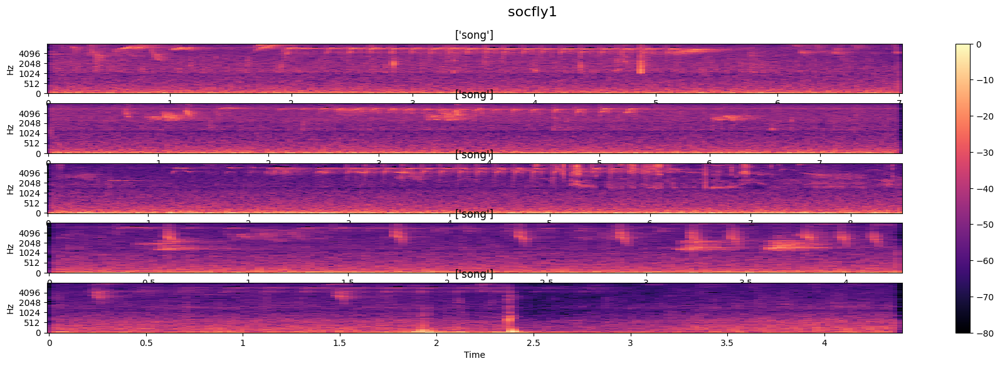

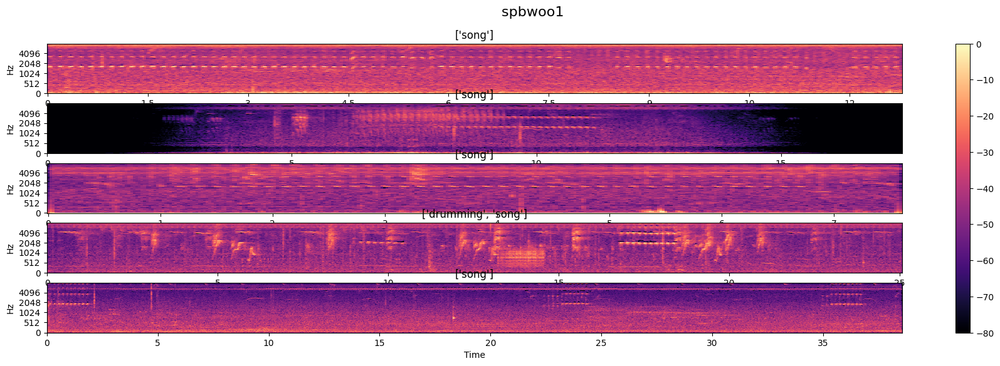

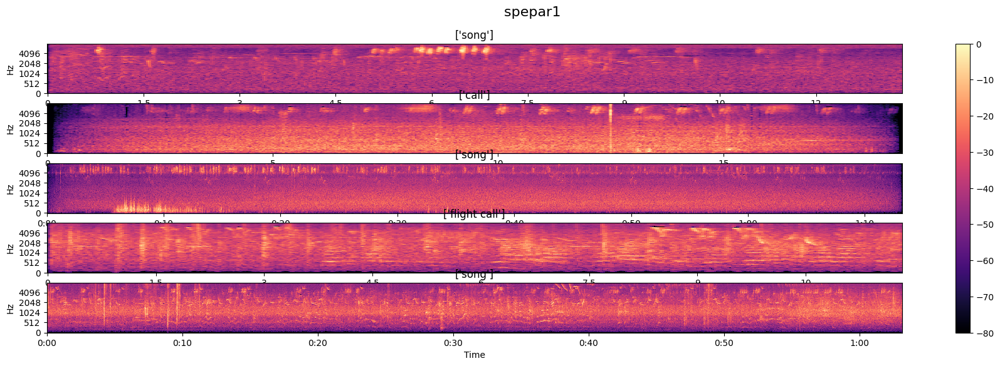

In [6]:
st = time.time()

for ipt in range(len(groggs)):
    sup_title = str(groggs[ipt][0]['file'].split('/')[0]).replace(" ","")
    lenlistdict = len(groggs[ipt])
    fig, ax = plt.subplots(lenlistdict, 1, figsize=(22, int(lenlistdict*1.2)))
    data_birds = []
    for i in range(lenlistdict):
        grogg = bc25_p_ta + str(groggs[ipt][i]['file']).replace(" ","")
        y, sr = librosa.load(grogg)
        groggs[ipt][i]['time'] = len(y) / sr
        S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=250, fmax=8_000)# S = librosa.stft(y) # 
        DB = librosa.power_to_db(S, ref=np.max) # DB = librosa.amplitude_to_db(abs(S)) # 

        fig.suptitle(sup_title+" "*14, fontsize=16)
        ax[i].set_title(groggs[ipt][i]['type'], fontsize=12) 
        
        img = librosa.display.specshow(DB, x_axis="time", y_axis="mel", sr=sr, fmax=8_000, ax=ax[i])

    plt.colorbar(img,ax=ax)
    
print('\n', round(time.time()-st,1))